# <p style = 'text-align :center;'>Used Car Quality Detection</p>

![](https://media.istockphoto.com/photos/shiny-car-for-sale-in-summer-weather-picture-id597261528?k=20&m=597261528&s=612x612&w=0&h=IqgPgOYjjNcamj8BP-v4f_94jhtyleR5NqmfVcAngZw=)

Course Project Submission For : [Machine Learning with Python: Zero to GBMs](https://zerotogbms.com)

## Problem Statement: [Don't Get Kicked!](https://www.kaggle.com/c/DontGetKicked)

![](https://i.imgur.com/0K94hYp.png)

One of the biggest challenges of an auto dealership purchasing a used car at an auto auction is the risk of that the vehicle might have serious issues that prevent it from being sold to customers. The auto community calls these unfortunate purchases "kicks".

Kicked cars often result when there are tampered odometers, mechanical issues the dealer is not able to address, issues with getting the vehicle title from the seller, or some other unforeseen problem. Kick cars can be very costly to dealers after transportation cost, throw-away repair work, and market losses in reselling the vehicle.

Modelers who can figure out which cars have a higher risk of being kick can provide real value to dealerships trying to provide the best inventory selection possible to their customers.

The challenge of this competition is to predict if the car purchased at the Auction is a Kick (bad buy).

## Installing the required libraries.

In [1]:
import numpy as np 
import pandas as pd 

In [2]:
!pip install opendatasets graphviz scikit-learn xgboost lightgbm --upgrade --quiet

## Downloading the Data


In [3]:
import os
import opendatasets as od
import pandas as pd

In [4]:
od.download('https://www.kaggle.com/c/DontGetKicked')

Skipping, found downloaded files in ".\DontGetKicked" (use force=True to force download)


In [5]:
os.listdir('DontGetKicked')

['Carvana_Data_Dictionary.txt',
 'example_entry.csv',
 'test.csv',
 'test.zip',
 'training.csv',
 'training.zip']

Load the data into Pandas dataframes.

In [6]:
car_df = pd.read_csv('./DontGetKicked/training.csv')
test_df = pd.read_csv('./DontGetKicked/test.csv')

In [7]:
car_df

,RefId,IsBadBuy,PurchDate,Auction,VehYear,VehicleAge,Make,Model,Trim,SubModel,...,MMRCurrentRetailAveragePrice,MMRCurrentRetailCleanPrice,PRIMEUNIT,AUCGUART,BYRNO,VNZIP1,VNST,VehBCost,IsOnlineSale,WarrantyCost
0,1,0,12/7/2009,ADESA,2006,3,MAZDA,MAZDA3,i,4D SEDAN I,...,11597.0,12409.0,NaN,NaN,21973,33619,FL,7100.0,0,1113
1,2,0,12/7/2009,ADESA,2004,5,DODGE,1500 RAM PICKUP 2WD,ST,QUAD CAB 4.7L SLT,...,11374.0,12791.0,NaN,NaN,19638,33619,FL,7600.0,0,1053
2,3,0,12/7/2009,ADESA,2005,4,DODGE,STRATUS V6,SXT,4D SEDAN SXT FFV,...,7146.0,8702.0,NaN,NaN,19638,33619,FL,4900.0,0,1389
3,4,0,12/7/2009,ADESA,2004,5,DODGE,NEON,SXT,4D SEDAN,...,4375.0,5518.0,NaN,NaN,19638,33619,FL,4100.0,0,630
4,5,0,12/7/2009,ADESA,2005,4,FORD,FOCUS,ZX3,2D COUPE ZX3,...,6739.0,7911.0,NaN,NaN,19638,33619,FL,4000.0,0,1020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72978,73010,1,12/2/2009,ADESA,2001,8,MERCURY,SABLE,GS,4D SEDAN GS,...,4836.0,5937.0,NaN,NaN,18111,30212,GA,4200.0,0,993
72979,73011,0,12/2/2009,ADESA,2007,2,CHEVROLET,MALIBU 4C,LS,4D SEDAN LS,...,10151.0,11652.0,NaN,NaN,18881,30212,GA,6200.0,0,1038
72980,73012,0,12/2/2009,ADESA,2005,4,JEEP,GRAND CHEROKEE 2WD V,Lar,4D WAGON LAREDO,...,11831.0,14402.0,NaN,NaN,18111,30212,GA,8200.0,0,1893
72981,73013,0,12/2/2009,ADESA,2006,3,CHEVROLET,IMPALA,LS,4D SEDAN LS,...,10099.0,11228.0,NaN,NaN,18881,30212,GA,7000.0,0,1974


In [8]:
test_df

,RefId,PurchDate,Auction,VehYear,VehicleAge,Make,Model,Trim,SubModel,Color,...,MMRCurrentRetailAveragePrice,MMRCurrentRetailCleanPrice,PRIMEUNIT,AUCGUART,BYRNO,VNZIP1,VNST,VehBCost,IsOnlineSale,WarrantyCost
0,73015,12/2/2009,ADESA,2005,4,PONTIAC,GRAND PRIX,Bas,4D SEDAN,SILVER,...,8557.0,9752.0,NaN,NaN,18881,30212,GA,6500.0,0,2152
1,73016,12/2/2009,ADESA,2005,4,CHEVROLET,MALIBU V6,LS,4D SEDAN LS,SILVER,...,7562.0,9296.0,NaN,NaN,18111,30212,GA,6300.0,0,1118
2,73017,12/2/2009,ADESA,2006,3,DODGE,DURANGO 2WD V8,Adv,4D SUV 4.7L ADVENTURER,SILVER,...,15340.0,16512.0,NaN,NaN,18111,30212,GA,9700.0,0,1215
3,73018,12/2/2009,ADESA,2002,7,SATURN,L SERIES,L20,4D SEDAN L200,GOLD,...,5725.0,6398.0,NaN,NaN,18881,30212,GA,4150.0,0,1933
4,73019,12/2/2009,ADESA,2007,2,HYUNDAI,ACCENT,GS,2D COUPE GS,BLUE,...,5914.0,7350.0,NaN,NaN,18111,30212,GA,4100.0,0,920
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48702,121742,11/17/2010,MANHEIM,2005,5,FORD,FIVE HUNDRED,SEL,4D SEDAN SEL,BLACK,...,9764.0,11395.0,NaN,NaN,20928,33411,FL,7955.0,0,1633
48703,121743,11/17/2010,MANHEIM,2007,3,TOYOTA,COROLLA,CE,4D SEDAN CE,GREEN,...,10283.0,11565.0,NaN,NaN,20928,33411,FL,7035.0,0,594
48704,121744,11/17/2010,MANHEIM,2006,4,KIA,SPECTRA,EX,4D SEDAN EX,BLACK,...,7871.0,9490.0,NO,GREEN,20928,33411,FL,6335.0,0,594
48705,121745,11/17/2010,MANHEIM,2005,5,MAZDA,MAZDA3,s,4D SEDAN GT,SILVER,...,8576.0,9937.0,NO,GREEN,20928,33411,FL,8055.0,0,1038


## DATA VISUALIZATION
 Studying the relationship between IsBadBuy and other parameters by plotting some graphs between them

In [9]:
car_df.shape

(72983, 34)

>Our Dataset (car_df) contains 72983 rows with 34 columns with holding information such as manufacturing date , reference Id , age of vehical etc.
Using this information, we have to estimate if the car is in a good condition to buy or not

In [10]:
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [11]:
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

### Data type for each column.

In [12]:
car_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 72983 entries, 0 to 72982
Data columns (total 34 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   RefId                              72983 non-null  int64  
 1   IsBadBuy                           72983 non-null  int64  
 2   PurchDate                          72983 non-null  object 
 3   Auction                            72983 non-null  object 
 4   VehYear                            72983 non-null  int64  
 5   VehicleAge                         72983 non-null  int64  
 6   Make                               72983 non-null  object 
 7   Model                              72983 non-null  object 
 8   Trim                               70623 non-null  object 
 9   SubModel                           72975 non-null  object 
 10  Color                              72975 non-null  object 
 11  Transmission                       72974 non-null  obj

> Lets see the correlation of the all the columns with IsBadBuy to get an idea of how there relationship is

In [13]:
correlation_matrix = car_df.corr()
correlation_matrix['IsBadBuy'].sort_values()

VehYear                             -0.158886
MMRAcquisitionAuctionAveragePrice   -0.109252
MMRCurrentAuctionAveragePrice       -0.109112
MMRCurrentAuctionCleanPrice         -0.104020
MMRCurrentRetailAveragePrice        -0.103914
MMRAcquisitionAuctionCleanPrice     -0.102954
MMRCurrentRetailCleanPrice          -0.100245
VehBCost                            -0.099911
MMRAcquisitionRetailAveragePrice    -0.087418
MMRAcquisitonRetailCleanPrice       -0.083665
BYRNO                               -0.061488
WheelTypeID                         -0.044620
IsOnlineSale                        -0.003697
VNZIP1                               0.005796
RefId                                0.023973
WarrantyCost                         0.052319
VehOdo                               0.082560
VehicleAge                           0.167164
IsBadBuy                             1.000000
Name: IsBadBuy, dtype: float64

>We see that vehical age , odometer reading of vehical , warrenty cost have the highest correlation values among all the parameter.
lets plot a graph to visualise there relationship

### 1) VehicleAge Vs IsBadBuy

In [14]:
car_df.VehicleAge.describe()

count    72983.000000
mean         4.176644
std          1.712210
min          0.000000
25%          3.000000
50%          4.000000
75%          5.000000
max          9.000000
Name: VehicleAge, dtype: float64

In [15]:
fig = px.histogram(x=car_df['VehicleAge'], marginal='box', color= car_df['IsBadBuy'], color_discrete_sequence=['red', 'yellow'], title='Vehicle Age vs Outcome' , text_auto = True)
fig.update_layout(bargap=0.1)
fig.show()

As we can see the older cars are more likely to be referred as 'Bad buy'

### 2) Vehicle Odometer reading Vs IsBadBuy

In [16]:
car_df.VehOdo.describe()

count     72983.000000
mean      71499.995917
std       14578.913128
min        4825.000000
25%       61837.000000
50%       73361.000000
75%       82436.000000
max      115717.000000
Name: VehOdo, dtype: float64

In [17]:
fig = px.histogram(x=car_df['VehOdo'], marginal='box', color= car_df['IsBadBuy'], color_discrete_sequence=['red', 'yellow'], title='Vehicle Odometer Reading vs BadBuy' , text_auto = True)
fig.update_layout(bargap=0.2)
fig.show()

As expected, the cars with hifger readings of odometer, are more likely to be referred as 'Bad buy'

### 3) Warranty Cost vs BadBuy 

In [18]:
car_df.WarrantyCost.describe()

count    72983.000000
mean      1276.580985
std        598.846788
min        462.000000
25%        837.000000
50%       1155.000000
75%       1623.000000
max       7498.000000
Name: WarrantyCost, dtype: float64

In [19]:
fig = px.histogram(x=car_df['WarrantyCost'], marginal='box', color= car_df['IsBadBuy'], color_discrete_sequence=['red', 'yellow'], title='Vehicle Warrenty Cost vs BadBuy' , text_auto = True)
fig.update_layout(bargap=0.1)
fig.show()

According to the boxplt, there is no apparent association of warranty cost to the outcome

According to the boxplt, there is no apparent association of car color to the outcome

### 4) Manufacturer vs BadBuy

In [20]:
fig = px.histogram(x = car_df['Make'],marginal='box', color = car_df['IsBadBuy'] ,color_discrete_sequence=['red', 'yellow'],title='Manufacturer vs BadBuy' , text_auto = True)
fig.update_layout(bargap=0.1)
fig.show()

We cannot conclude a definative outcome from the above graph, thus we say there is no definative relationship b/w manufacturer and Car

### Transmission type vs outcome

In [21]:
fig = px.histogram(x=car_df['Transmission'],marginal='box',color=car_df['IsBadBuy'],color_discrete_sequence=['red', 'yellow'],title='Vehicle Manufacturer vs Outcome')
fig.update_layout(bargap=0.1)
fig.show()

In [22]:
car_df.Transmission.value_counts()

AUTO      70398
MANUAL     2575
Manual        1
Name: Transmission, dtype: int64

In [23]:
#fixing the typo error
car_df['Transmission'].loc[(car_df['Transmission'] == 'Manual')] = 'MANUAL'
car_df.Transmission.value_counts()

C:\Users\ASUS\anaconda3\lib\site-packages\pandas\core\indexing.py:1732: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



AUTO      70398
MANUAL     2576
Name: Transmission, dtype: int64

> There is no definate relationship b/w transmission type and BadBuy. 
But corrected 'manual' to 'MANUAL' to uniformity of the dataset

## Preprocessing and Feature Engineering


### Identify Input and Target Columns

In [24]:
car_df.columns

Index(['RefId', 'IsBadBuy', 'PurchDate', 'Auction', 'VehYear', 'VehicleAge',
       'Make', 'Model', 'Trim', 'SubModel', 'Color', 'Transmission',
       'WheelTypeID', 'WheelType', 'VehOdo', 'Nationality', 'Size',
       'TopThreeAmericanName', 'MMRAcquisitionAuctionAveragePrice',
       'MMRAcquisitionAuctionCleanPrice', 'MMRAcquisitionRetailAveragePrice',
       'MMRAcquisitonRetailCleanPrice', 'MMRCurrentAuctionAveragePrice',
       'MMRCurrentAuctionCleanPrice', 'MMRCurrentRetailAveragePrice',
       'MMRCurrentRetailCleanPrice', 'PRIMEUNIT', 'AUCGUART', 'BYRNO',
       'VNZIP1', 'VNST', 'VehBCost', 'IsOnlineSale', 'WarrantyCost'],
      dtype='object')

> We can ignore columns as refId , purchase Date , primeUnit and AUCGUART as they are irrelavant and some of them have many values missing which can cause inaccuracies while training our model on this data

In [25]:
input_columns = ['Auction', 'VehYear', 'VehicleAge', 'Make', 'Model', 
              'Trim', 'SubModel', 'Color', 'Transmission', 'WheelTypeID', 
              'VehOdo', 'Nationality', 'Size', 'TopThreeAmericanName', 
              'MMRAcquisitionAuctionAveragePrice', 'MMRAcquisitionAuctionCleanPrice', 
              'MMRAcquisitionRetailAveragePrice', 'MMRAcquisitonRetailCleanPrice', 
              'MMRCurrentAuctionAveragePrice', 'MMRCurrentAuctionCleanPrice', 
              'MMRCurrentRetailAveragePrice', 'MMRCurrentRetailCleanPrice', 'PRIMEUNIT', 
              'AUCGUART', 'BYRNO', 'VNZIP1', 'VNST', 'VehBCost', 'IsOnlineSale', 'WarrantyCost', 
              'PurchDate']

target_columns = "IsBadBuy" 

In [26]:
input_columns

['Auction',
 'VehYear',
 'VehicleAge',
 'Make',
 'Model',
 'Trim',
 'SubModel',
 'Color',
 'Transmission',
 'WheelTypeID',
 'VehOdo',
 'Nationality',
 'Size',
 'TopThreeAmericanName',
 'MMRAcquisitionAuctionAveragePrice',
 'MMRAcquisitionAuctionCleanPrice',
 'MMRAcquisitionRetailAveragePrice',
 'MMRAcquisitonRetailCleanPrice',
 'MMRCurrentAuctionAveragePrice',
 'MMRCurrentAuctionCleanPrice',
 'MMRCurrentRetailAveragePrice',
 'MMRCurrentRetailCleanPrice',
 'PRIMEUNIT',
 'AUCGUART',
 'BYRNO',
 'VNZIP1',
 'VNST',
 'VehBCost',
 'IsOnlineSale',
 'WarrantyCost',
 'PurchDate']

In [27]:
target_columns

'IsBadBuy'

## SPLITTING DATA INTO TEST AND TRAINING DATA

In [28]:
from sklearn.model_selection import train_test_split

In [29]:
train_val_df, test_df = train_test_split(car_df, test_size=0.2, random_state=42)
train_df, val_df = train_test_split(train_val_df, test_size=0.25, random_state=42)

In [30]:
train_val_df.shape , test_df.shape , train_df.shape, val_df.shape

((58386, 34), (14597, 34), (43789, 34), (14597, 34))

In [31]:
train_df

,RefId,IsBadBuy,PurchDate,Auction,VehYear,VehicleAge,Make,Model,Trim,SubModel,...,MMRCurrentRetailAveragePrice,MMRCurrentRetailCleanPrice,PRIMEUNIT,AUCGUART,BYRNO,VNZIP1,VNST,VehBCost,IsOnlineSale,WarrantyCost
6826,6833,0,8/24/2010,MANHEIM,2005,5,HONDA,ACCORD V6,EX,4D SEDAN EX AUTO,...,12785.0,14072.0,NaN,NaN,835,85040,AZ,9925.0,0,1341
53731,53759,0,11/3/2009,OTHER,2008,1,DODGE,CALIBER,SE,4D WAGON,...,11913.0,12272.0,NaN,NaN,99761,74135,OK,6700.0,0,754
11907,11916,0,4/2/2010,OTHER,2003,7,FORD,ESCAPE 2WD V6,XLT,4D CUV 3.0L XLT,...,7990.0,8945.0,NaN,NaN,17212,79605,TX,6685.0,0,1283
28877,28898,0,4/7/2010,MANHEIM,2004,6,DODGE,DAKOTA PICKUP 2WD V6,SXT,EXT CAB 3.7L SXT,...,7524.0,8639.0,NaN,NaN,3453,80011,CO,6640.0,0,920
18459,18471,0,12/15/2010,MANHEIM,2002,8,CHEVROLET,TRACKER 2WD 4C,Bas,4D SUV HARDTOP 2.0L,...,5586.0,6033.0,NaN,NaN,19619,32824,FL,5050.0,0,1125
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13255,13265,0,12/13/2010,MANHEIM,2008,2,CHRYSLER,SEBRING 4C,LX,4D SEDAN LX,...,11580.0,12585.0,NaN,NaN,5546,27542,NC,8130.0,0,920
7466,7473,0,2/4/2010,MANHEIM,2006,4,CHEVROLET,MALIBU MAXX V6,LT,4D SEDAN LT,...,10382.0,11506.0,NaN,NaN,18881,30272,GA,6695.0,0,1272
55183,55211,1,10/5/2010,MANHEIM,2006,4,FORD,FUSION V6,SE,4D SEDAN SE,...,10306.0,12340.0,NaN,NaN,20234,97217,OR,8445.0,0,1373
1962,1964,0,11/2/2009,ADESA,2004,5,CHEVROLET,MALIBU 4C,Cla,4D SEDAN CLASSIC,...,5351.0,6700.0,NaN,NaN,5546,33619,FL,4200.0,0,920


In [32]:
val_df

,RefId,IsBadBuy,PurchDate,Auction,VehYear,VehicleAge,Make,Model,Trim,SubModel,...,MMRCurrentRetailAveragePrice,MMRCurrentRetailCleanPrice,PRIMEUNIT,AUCGUART,BYRNO,VNZIP1,VNST,VehBCost,IsOnlineSale,WarrantyCost
69198,69230,1,11/20/2009,ADESA,2006,3,CHEVROLET,TRAILBLAZER EXT 4WD,LS,4D SUV 4.2L,...,17644.0,18744.0,NaN,NaN,16926,91752,CA,9015.0,0,1974
64916,64947,0,6/25/2009,MANHEIM,2008,1,PONTIAC,G6 4C,Bas,4D SEDAN SE,...,10606.0,11662.0,NaN,NaN,19662,77061,TX,7295.0,0,923
45793,45817,1,10/28/2009,MANHEIM,2006,3,FORD,ESCAPE 2WD V6 3.0L V,XLT,4D CUV 3.0L XLT,...,12584.0,14192.0,NaN,NaN,18822,64161,MO,7170.0,0,983
27360,27378,0,2/25/2009,OTHER,2005,4,CHEVROLET,AVEO 1.6L I-4 EFI DO,LS,4D SEDAN,...,8206.0,9454.0,NaN,NaN,835,85009,AZ,5670.0,0,671
51120,51148,0,3/10/2010,OTHER,2003,7,SATURN,ION,2,4D SEDAN LEVEL 2,...,4868.0,6209.0,NaN,NaN,835,85009,AZ,4685.0,0,1153
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13607,13617,0,11/3/2009,MANHEIM,2004,5,DODGE,DURANGO 4WD V8,SLT,4D SUV 5.7L SLT,...,11620.0,14156.0,NaN,NaN,16044,21075,MD,8715.0,0,1918
42355,42379,0,2/4/2009,MANHEIM,2001,8,CHEVROLET,MONTE CARLO 3.8L V6,SS,2D COUPE SS,...,5108.0,6284.0,NaN,NaN,20740,22801,VA,4200.0,0,2651
56721,56749,0,1/27/2009,MANHEIM,2004,5,DODGE,DURANGO 2WD V8 4.7L,ST,4D SUV 4.7L,...,7011.0,7761.0,NaN,NaN,16926,92504,CA,6695.0,0,1086
71385,71417,1,7/9/2009,ADESA,2003,6,FORD,FOCUS 2.0L I4 SPI,LX,4D SEDAN LX,...,2915.0,3653.0,NaN,NaN,18880,28273,NC,4160.0,0,1220


In [33]:
test_df

,RefId,IsBadBuy,PurchDate,Auction,VehYear,VehicleAge,Make,Model,Trim,SubModel,...,MMRCurrentRetailAveragePrice,MMRCurrentRetailCleanPrice,PRIMEUNIT,AUCGUART,BYRNO,VNZIP1,VNST,VehBCost,IsOnlineSale,WarrantyCost
27851,27871,0,6/3/2009,MANHEIM,2003,6,FORD,WINDSTAR FWD V6 3.8L,LX,PASSENGER 3.8L LX,...,3258.0,4284.0,NaN,NaN,5546,32824,FL,4200.0,0,2157
51596,51624,0,11/17/2009,MANHEIM,2004,5,FORD,EXPLORER 4WD V6,XLS,4D SUV 4.0L FFV XLS,...,10117.0,11622.0,NaN,NaN,99750,80011,CO,6800.0,0,1893
31933,31955,0,8/14/2009,OTHER,2005,4,CHRYSLER,PACIFICA FWD 3.5L V6,Tou,4D SPORT TOURING,...,7628.0,9145.0,NaN,NaN,20740,29461,SC,8800.0,0,1086
12335,12344,0,7/28/2009,OTHER,2006,3,PONTIAC,G6 V6 3.5L V6 SFI,Bas,4D SEDAN,...,7550.0,9151.0,NaN,NaN,21053,95673,CA,7305.0,0,1272
68933,68965,0,9/10/2009,ADESA,2006,3,MITSUBISHI,ENDEAVOR FWD 3.8L V6,LS,4D SPORT UTILITY LS,...,11631.0,12895.0,NaN,NaN,21973,32219,FL,8300.0,0,569
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52554,52582,0,2/18/2010,MANHEIM,2004,6,MAZDA,MAZDA6,i,4D SEDAN I,...,8699.0,9797.0,NaN,NaN,10430,39402,MS,8405.0,1,1003
50223,50251,0,2/25/2009,MANHEIM,2004,5,DODGE,CARAVAN FWD V6 3.3L,SE,MINIVAN 3.3L SE,...,6128.0,7512.0,NaN,NaN,18822,78219,TX,4335.0,0,1763
15260,15270,1,4/21/2010,MANHEIM,2005,5,CHEVROLET,IMPALA,Bas,4D SEDAN,...,7033.0,8788.0,NaN,NaN,20234,94544,CA,6035.0,0,1974
26629,26647,0,10/6/2009,MANHEIM,2007,2,DODGE,CALIBER 2.0L I4 SFI,Bas,4D WAGON,...,11066.0,12247.0,NaN,NaN,17212,75050,TX,7540.0,0,825


In [34]:
train_inputs = train_df[input_columns].copy()
train_targets = train_df[target_columns].copy()
val_inputs = val_df[input_columns].copy()
val_targets = val_df[target_columns].copy()
test_inputs = test_df[input_columns].copy()
test_targets = test_df[target_columns].copy()

## INDENTIFYING NUMERIC AND CATEGORICAL COLUMNS IN THE DATASET

In [35]:
import numpy as np 

In [36]:
numeric_cols = train_inputs.select_dtypes(include = np.number).columns.to_list()
categorical_cols = train_inputs.select_dtypes(include = 'object').columns.to_list()

In [37]:
train_inputs[numeric_cols]

,VehYear,VehicleAge,WheelTypeID,VehOdo,MMRAcquisitionAuctionAveragePrice,MMRAcquisitionAuctionCleanPrice,MMRAcquisitionRetailAveragePrice,MMRAcquisitonRetailCleanPrice,MMRCurrentAuctionAveragePrice,MMRCurrentAuctionCleanPrice,MMRCurrentRetailAveragePrice,MMRCurrentRetailCleanPrice,BYRNO,VNZIP1,VehBCost,IsOnlineSale,WarrantyCost
6826,2005,5,1.0,90701,9255.0,10694.0,13253.0,14697.0,8304.0,9350.0,12785.0,14072.0,835,85040,9925.0,0,1341
53731,2008,1,2.0,51312,6955.0,7534.0,8011.0,8637.0,8033.0,8513.0,11913.0,12272.0,99761,74135,6700.0,0,754
11907,2003,7,1.0,88843,4799.0,6176.0,7687.0,9218.0,4268.0,5487.0,7990.0,8945.0,17212,79605,6685.0,0,1283
28877,2004,6,1.0,52068,5256.0,6879.0,8889.0,10551.0,3823.0,4931.0,7524.0,8639.0,3453,80011,6640.0,0,920
18459,2002,8,2.0,63391,3549.0,4559.0,6050.0,6962.0,3080.0,3648.0,5586.0,6033.0,19619,32824,5050.0,0,1125
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13255,2008,2,2.0,52073,7889.0,8662.0,10939.0,11932.0,7929.0,9194.0,11580.0,12585.0,5546,27542,8130.0,0,920
7466,2006,4,1.0,78300,6332.0,7610.0,10518.0,12640.0,6603.0,7861.0,10382.0,11506.0,18881,30272,6695.0,0,1272
55183,2006,4,1.0,81703,6713.0,8329.0,10811.0,12554.0,6043.0,7862.0,10306.0,12340.0,20234,97217,8445.0,0,1373
1962,2004,5,2.0,56853,2997.0,4202.0,3737.0,5038.0,2290.0,3228.0,5351.0,6700.0,5546,33619,4200.0,0,920


In [38]:
train_inputs[categorical_cols]

,Auction,Make,Model,Trim,SubModel,Color,Transmission,Nationality,Size,TopThreeAmericanName,PRIMEUNIT,AUCGUART,VNST,PurchDate
6826,MANHEIM,HONDA,ACCORD V6,EX,4D SEDAN EX AUTO,SILVER,AUTO,TOP LINE ASIAN,MEDIUM,OTHER,NaN,NaN,AZ,8/24/2010
53731,OTHER,DODGE,CALIBER,SE,4D WAGON,SILVER,AUTO,AMERICAN,MEDIUM,CHRYSLER,NaN,NaN,OK,11/3/2009
11907,OTHER,FORD,ESCAPE 2WD V6,XLT,4D CUV 3.0L XLT,WHITE,AUTO,AMERICAN,SMALL SUV,FORD,NaN,NaN,TX,4/2/2010
28877,MANHEIM,DODGE,DAKOTA PICKUP 2WD V6,SXT,EXT CAB 3.7L SXT,WHITE,AUTO,AMERICAN,SMALL TRUCK,CHRYSLER,NaN,NaN,CO,4/7/2010
18459,MANHEIM,CHEVROLET,TRACKER 2WD 4C,Bas,4D SUV HARDTOP 2.0L,WHITE,AUTO,AMERICAN,SMALL SUV,GM,NaN,NaN,FL,12/15/2010
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13255,MANHEIM,CHRYSLER,SEBRING 4C,LX,4D SEDAN LX,BLUE,AUTO,AMERICAN,MEDIUM,CHRYSLER,NaN,NaN,NC,12/13/2010
7466,MANHEIM,CHEVROLET,MALIBU MAXX V6,LT,4D SEDAN LT,SILVER,AUTO,AMERICAN,MEDIUM,GM,NaN,NaN,GA,2/4/2010
55183,MANHEIM,FORD,FUSION V6,SE,4D SEDAN SE,BLUE,AUTO,AMERICAN,MEDIUM,FORD,NaN,NaN,OR,10/5/2010
1962,ADESA,CHEVROLET,MALIBU 4C,Cla,4D SEDAN CLASSIC,WHITE,AUTO,AMERICAN,MEDIUM,GM,NaN,NaN,FL,11/2/2009


## FINDING NULL VALUES AND REPLACING THEM

In [39]:
train_inputs[numeric_cols].isna().sum()

VehYear                                 0
VehicleAge                              0
WheelTypeID                          1901
VehOdo                                  0
MMRAcquisitionAuctionAveragePrice      12
MMRAcquisitionAuctionCleanPrice        12
MMRAcquisitionRetailAveragePrice       12
MMRAcquisitonRetailCleanPrice          12
MMRCurrentAuctionAveragePrice         193
MMRCurrentAuctionCleanPrice           193
MMRCurrentRetailAveragePrice          193
MMRCurrentRetailCleanPrice            193
BYRNO                                   0
VNZIP1                                  0
VehBCost                                0
IsOnlineSale                            0
WarrantyCost                            0
dtype: int64

In [40]:
from sklearn.impute import SimpleImputer

In [41]:
imputer = SimpleImputer(strategy = "mean")

In [42]:
imputer.fit(car_df[numeric_cols])

SimpleImputer()

In [43]:
train_inputs[numeric_cols] = imputer.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = imputer.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = imputer.transform(test_inputs[numeric_cols])

In [44]:
train_inputs[numeric_cols].isna().sum()

VehYear                              0
VehicleAge                           0
WheelTypeID                          0
VehOdo                               0
MMRAcquisitionAuctionAveragePrice    0
MMRAcquisitionAuctionCleanPrice      0
MMRAcquisitionRetailAveragePrice     0
MMRAcquisitonRetailCleanPrice        0
MMRCurrentAuctionAveragePrice        0
MMRCurrentAuctionCleanPrice          0
MMRCurrentRetailAveragePrice         0
MMRCurrentRetailCleanPrice           0
BYRNO                                0
VNZIP1                               0
VehBCost                             0
IsOnlineSale                         0
WarrantyCost                         0
dtype: int64

## SCALING VALUES IN THE RANGE 0-1

In [45]:
from sklearn.preprocessing import MinMaxScaler

In [46]:
scaler = MinMaxScaler()

In [47]:
scaler.fit(car_df[numeric_cols])

MinMaxScaler()

In [48]:
train_inputs[numeric_cols] = scaler.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = scaler.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = scaler.transform(test_inputs[numeric_cols])

In [49]:
train_inputs[numeric_cols]

,VehYear,VehicleAge,WheelTypeID,VehOdo,MMRAcquisitionAuctionAveragePrice,MMRAcquisitionAuctionCleanPrice,MMRAcquisitionRetailAveragePrice,MMRAcquisitonRetailCleanPrice,MMRCurrentAuctionAveragePrice,MMRCurrentAuctionCleanPrice,MMRCurrentRetailAveragePrice,MMRCurrentRetailCleanPrice,BYRNO,VNZIP1,VehBCost,IsOnlineSale,WarrantyCost
6826,0.444444,0.555556,0.333333,0.774411,0.259084,0.290133,0.339125,0.354298,0.232462,0.253669,0.327149,0.342701,0.000000,0.852955,0.218263,0.0,0.124929
53731,0.777778,0.111111,0.666667,0.419210,0.194698,0.204401,0.204990,0.208211,0.224875,0.230961,0.304836,0.298865,1.000000,0.739903,0.147334,0.0,0.041501
11907,0.222222,0.777778,0.333333,0.757656,0.134343,0.167557,0.196699,0.222217,0.119478,0.148865,0.204452,0.217841,0.165548,0.796610,0.147004,0.0,0.116686
28877,0.333333,0.666667,0.333333,0.426027,0.147136,0.186630,0.227456,0.254351,0.107021,0.133780,0.192528,0.210389,0.026464,0.800819,0.146015,0.0,0.065094
18459,0.111111,0.888889,0.666667,0.528135,0.099351,0.123688,0.154811,0.167832,0.086221,0.098972,0.142938,0.146924,0.189879,0.311632,0.111045,0.0,0.094230
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13255,0.777778,0.222222,0.666667,0.426072,0.220844,0.235004,0.279913,0.287643,0.221964,0.249437,0.296315,0.306488,0.047621,0.256873,0.178785,0.0,0.065094
7466,0.555556,0.444444,0.333333,0.662582,0.177258,0.206462,0.269140,0.304710,0.184844,0.213272,0.265660,0.280210,0.182419,0.285175,0.147224,0.0,0.115122
55183,0.555556,0.444444,0.333333,0.693269,0.187923,0.225969,0.276638,0.302637,0.169167,0.213299,0.263715,0.300521,0.196096,0.979193,0.185713,0.0,0.129477
1962,0.333333,0.555556,0.666667,0.469177,0.083898,0.114002,0.095624,0.121450,0.064106,0.087577,0.136924,0.163168,0.047621,0.319874,0.092351,0.0,0.065094


In [50]:
val_inputs[numeric_cols]

,VehYear,VehicleAge,WheelTypeID,VehOdo,MMRAcquisitionAuctionAveragePrice,MMRAcquisitionAuctionCleanPrice,MMRAcquisitionRetailAveragePrice,MMRAcquisitonRetailCleanPrice,MMRCurrentAuctionAveragePrice,MMRCurrentAuctionCleanPrice,MMRCurrentRetailAveragePrice,MMRCurrentRetailCleanPrice,BYRNO,VNZIP1,VehBCost,IsOnlineSale,WarrantyCost
69198,0.555556,0.333333,0.333333,0.645141,0.322098,0.389132,0.330757,0.385468,0.353200,0.374671,0.451484,0.456480,0.162657,0.922538,0.198249,0.0,0.214895
64916,0.777778,0.111111,0.666667,0.508206,0.261939,0.280393,0.271392,0.281134,0.261939,0.280393,0.271392,0.284010,0.190314,0.770236,0.160421,0.0,0.065520
45793,0.555556,0.333333,0.333333,0.704352,0.236829,0.289563,0.246597,0.289933,0.245227,0.285710,0.322006,0.345624,0.181823,0.636502,0.157671,0.0,0.074048
27360,0.444444,0.444444,0.666667,0.473984,0.101898,0.119998,0.113383,0.127212,0.199737,0.224938,0.209980,0.230237,0.000000,0.852633,0.124681,0.0,0.029704
51120,0.222222,0.777778,0.666667,0.739828,0.096467,0.122955,0.148874,0.168820,0.072364,0.101251,0.124565,0.151210,0.000000,0.852633,0.103018,0.0,0.098209
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13607,0.333333,0.555556,0.333333,0.810843,0.232042,0.283404,0.241863,0.284027,0.208779,0.262433,0.297339,0.344747,0.153741,0.189830,0.191651,0.0,0.206936
42355,0.000000,0.888889,0.333333,0.776278,0.113823,0.137280,0.125154,0.143797,0.119450,0.145311,0.130706,0.153037,0.201211,0.207723,0.092351,0.0,0.311114
56721,0.333333,0.555556,0.666667,0.497268,0.176586,0.191242,0.187129,0.195579,0.168776,0.182398,0.179401,0.189007,0.162657,0.930334,0.147224,0.0,0.088687
71385,0.222222,0.666667,0.666667,0.471756,0.062594,0.079194,0.074591,0.088062,0.062594,0.079194,0.074591,0.088963,0.182409,0.264452,0.091471,0.0,0.107732


In [51]:
test_inputs[numeric_cols]

,VehYear,VehicleAge,WheelTypeID,VehOdo,MMRAcquisitionAuctionAveragePrice,MMRAcquisitionAuctionCleanPrice,MMRAcquisitionRetailAveragePrice,MMRAcquisitonRetailCleanPrice,MMRCurrentAuctionAveragePrice,MMRCurrentAuctionCleanPrice,MMRCurrentRetailAveragePrice,MMRCurrentRetailCleanPrice,BYRNO,VNZIP1,VehBCost,IsOnlineSale,WarrantyCost
27851,0.222222,0.666667,0.666667,0.587806,0.074940,0.098348,0.086771,0.106432,0.071497,0.095065,0.083367,0.104330,0.047621,0.311632,0.092351,0.0,0.240904
51596,0.333333,0.555556,1.000000,0.719646,0.156822,0.188611,0.167605,0.193048,0.181205,0.215795,0.258879,0.283035,0.999889,0.800819,0.149534,0.0,0.203383
31933,0.444444,0.444444,0.333333,0.491866,0.193214,0.224830,0.203531,0.227810,0.184760,0.217179,0.195189,0.222712,0.201211,0.276768,0.193521,0.0,0.088687
12335,0.555556,0.333333,0.333333,0.625428,0.206343,0.234163,0.216505,0.236753,0.182745,0.217315,0.193193,0.222858,0.204375,0.963187,0.160640,0.0,0.115122
68933,0.555556,0.333333,0.333333,0.630866,0.249594,0.290187,0.259186,0.290536,0.230558,0.256545,0.297620,0.314037,0.213675,0.305360,0.182524,0.0,0.015208
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52554,0.333333,0.666667,0.333333,0.448463,0.138542,0.174856,0.214150,0.243479,0.151055,0.175859,0.222595,0.238590,0.096992,0.379826,0.184833,1.0,0.076890
50223,0.333333,0.555556,0.666667,0.701989,0.079335,0.087062,0.091121,0.095608,0.145876,0.176158,0.156807,0.182943,0.181823,0.782241,0.095320,0.0,0.184906
15260,0.444444,0.555556,0.666667,0.621262,0.122725,0.152717,0.199693,0.228533,0.121830,0.152473,0.179964,0.214018,0.196096,0.951482,0.132709,0.0,0.214895
26629,0.666667,0.222222,0.666667,0.512309,0.212922,0.248298,0.222979,0.250325,0.213846,0.240782,0.283163,0.298256,0.165548,0.749388,0.165809,0.0,0.051592


> ## Encoding the categorical columns to use them as numerical data

In [52]:
from sklearn.preprocessing import OneHotEncoder

In [53]:
encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')

In [54]:
train_inputs[categorical_cols] = train_inputs[categorical_cols].fillna('Unknown')
val_inputs[categorical_cols] = val_inputs[categorical_cols].fillna('Unknown')
test_inputs[categorical_cols] = test_inputs[categorical_cols].fillna('Unknown')

In [55]:
encoder.fit(train_inputs[categorical_cols])

OneHotEncoder(handle_unknown='ignore', sparse=False)

In [56]:
encoded_cols = list(encoder.get_feature_names(categorical_cols))
encoded_cols

C:\Users\ASUS\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



['Auction_ADESA',
 'Auction_MANHEIM',
 'Auction_OTHER',
 'Make_ACURA',
 'Make_BUICK',
 'Make_CADILLAC',
 'Make_CHEVROLET',
 'Make_CHRYSLER',
 'Make_DODGE',
 'Make_FORD',
 'Make_GMC',
 'Make_HONDA',
 'Make_HUMMER',
 'Make_HYUNDAI',
 'Make_INFINITI',
 'Make_ISUZU',
 'Make_JEEP',
 'Make_KIA',
 'Make_LEXUS',
 'Make_LINCOLN',
 'Make_MAZDA',
 'Make_MERCURY',
 'Make_MINI',
 'Make_MITSUBISHI',
 'Make_NISSAN',
 'Make_OLDSMOBILE',
 'Make_PLYMOUTH',
 'Make_PONTIAC',
 'Make_SATURN',
 'Make_SCION',
 'Make_SUBARU',
 'Make_SUZUKI',
 'Make_TOYOTA',
 'Make_VOLKSWAGEN',
 'Make_VOLVO',
 'Model_1500 RAM PICKUP 2WD',
 'Model_1500 RAM PICKUP 4WD',
 'Model_1500 SIERRA PICKUP 2',
 'Model_1500 SIERRA PICKUP 4',
 'Model_1500 SILVERADO PICKU',
 'Model_1500HD SIERRA PICKUP',
 'Model_1500HD SILVERADO PIC',
 'Model_2500 RAM PICKUP 2WD',
 'Model_2500 RAM PICKUP 4WD',
 'Model_2500 SILVERADO PICKU',
 'Model_2500HD SILVERADO PIC',
 'Model_3.2 CL 3.2L V 6 NA S',
 'Model_3.2 TL',
 'Model_3.2 TL 3.2L V6 EFI',
 'Model_3.2 

In [57]:
train_inputs[encoded_cols] = encoder.transform(train_inputs[categorical_cols])
val_inputs[encoded_cols] = encoder.transform(val_inputs[categorical_cols])
test_inputs[encoded_cols] = encoder.transform(test_inputs[categorical_cols])

C:\Users\ASUS\anaconda3\lib\site-packages\pandas\core\frame.py:3678: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\ASUS\anaconda3\lib\site-packages\pandas\core\frame.py:3678: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\ASUS\anaconda3\lib\site-packages\pandas\core\frame.py:3678: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fr

In [58]:
type(train_inputs[encoded_cols])

pandas.core.frame.DataFrame

In [59]:
train_inputs

,Auction,VehYear,VehicleAge,Make,Model,Trim,SubModel,Color,Transmission,WheelTypeID,...,PurchDate_9/30/2009,PurchDate_9/30/2010,PurchDate_9/4/2009,PurchDate_9/6/2010,PurchDate_9/7/2009,PurchDate_9/7/2010,PurchDate_9/8/2009,PurchDate_9/8/2010,PurchDate_9/9/2009,PurchDate_9/9/2010
6826,MANHEIM,0.444444,0.555556,HONDA,ACCORD V6,EX,4D SEDAN EX AUTO,SILVER,AUTO,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
53731,OTHER,0.777778,0.111111,DODGE,CALIBER,SE,4D WAGON,SILVER,AUTO,0.666667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11907,OTHER,0.222222,0.777778,FORD,ESCAPE 2WD V6,XLT,4D CUV 3.0L XLT,WHITE,AUTO,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28877,MANHEIM,0.333333,0.666667,DODGE,DAKOTA PICKUP 2WD V6,SXT,EXT CAB 3.7L SXT,WHITE,AUTO,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
18459,MANHEIM,0.111111,0.888889,CHEVROLET,TRACKER 2WD 4C,Bas,4D SUV HARDTOP 2.0L,WHITE,AUTO,0.666667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13255,MANHEIM,0.777778,0.222222,CHRYSLER,SEBRING 4C,LX,4D SEDAN LX,BLUE,AUTO,0.666667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7466,MANHEIM,0.555556,0.444444,CHEVROLET,MALIBU MAXX V6,LT,4D SEDAN LT,SILVER,AUTO,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
55183,MANHEIM,0.555556,0.444444,FORD,FUSION V6,SE,4D SEDAN SE,BLUE,AUTO,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1962,ADESA,0.333333,0.555556,CHEVROLET,MALIBU 4C,Cla,4D SEDAN CLASSIC,WHITE,AUTO,0.666667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [60]:
val_inputs

,Auction,VehYear,VehicleAge,Make,Model,Trim,SubModel,Color,Transmission,WheelTypeID,...,PurchDate_9/30/2009,PurchDate_9/30/2010,PurchDate_9/4/2009,PurchDate_9/6/2010,PurchDate_9/7/2009,PurchDate_9/7/2010,PurchDate_9/8/2009,PurchDate_9/8/2010,PurchDate_9/9/2009,PurchDate_9/9/2010
69198,ADESA,0.555556,0.333333,CHEVROLET,TRAILBLAZER EXT 4WD,LS,4D SUV 4.2L,BLUE,AUTO,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
64916,MANHEIM,0.777778,0.111111,PONTIAC,G6 4C,Bas,4D SEDAN SE,SILVER,AUTO,0.666667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
45793,MANHEIM,0.555556,0.333333,FORD,ESCAPE 2WD V6 3.0L V,XLT,4D CUV 3.0L XLT,BLUE,AUTO,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
27360,OTHER,0.444444,0.444444,CHEVROLET,AVEO 1.6L I-4 EFI DO,LS,4D SEDAN,SILVER,AUTO,0.666667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
51120,OTHER,0.222222,0.777778,SATURN,ION,2,4D SEDAN LEVEL 2,GOLD,AUTO,0.666667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13607,MANHEIM,0.333333,0.555556,DODGE,DURANGO 4WD V8,SLT,4D SUV 5.7L SLT,GREY,AUTO,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
42355,MANHEIM,0.000000,0.888889,CHEVROLET,MONTE CARLO 3.8L V6,SS,2D COUPE SS,RED,AUTO,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
56721,MANHEIM,0.333333,0.555556,DODGE,DURANGO 2WD V8 4.7L,ST,4D SUV 4.7L,WHITE,AUTO,0.666667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
71385,ADESA,0.222222,0.666667,FORD,FOCUS 2.0L I4 SPI,LX,4D SEDAN LX,GOLD,AUTO,0.666667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [61]:
test_inputs

,Auction,VehYear,VehicleAge,Make,Model,Trim,SubModel,Color,Transmission,WheelTypeID,...,PurchDate_9/30/2009,PurchDate_9/30/2010,PurchDate_9/4/2009,PurchDate_9/6/2010,PurchDate_9/7/2009,PurchDate_9/7/2010,PurchDate_9/8/2009,PurchDate_9/8/2010,PurchDate_9/9/2009,PurchDate_9/9/2010
27851,MANHEIM,0.222222,0.666667,FORD,WINDSTAR FWD V6 3.8L,LX,PASSENGER 3.8L LX,SILVER,AUTO,0.666667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
51596,MANHEIM,0.333333,0.555556,FORD,EXPLORER 4WD V6,XLS,4D SUV 4.0L FFV XLS,WHITE,AUTO,1.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31933,OTHER,0.444444,0.444444,CHRYSLER,PACIFICA FWD 3.5L V6,Tou,4D SPORT TOURING,RED,AUTO,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12335,OTHER,0.555556,0.333333,PONTIAC,G6 V6 3.5L V6 SFI,Bas,4D SEDAN,WHITE,AUTO,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
68933,ADESA,0.555556,0.333333,MITSUBISHI,ENDEAVOR FWD 3.8L V6,LS,4D SPORT UTILITY LS,GREY,AUTO,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52554,MANHEIM,0.333333,0.666667,MAZDA,MAZDA6,i,4D SEDAN I,BLACK,AUTO,0.333333,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50223,MANHEIM,0.333333,0.555556,DODGE,CARAVAN FWD V6 3.3L,SE,MINIVAN 3.3L SE,SILVER,AUTO,0.666667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
15260,MANHEIM,0.444444,0.555556,CHEVROLET,IMPALA,Bas,4D SEDAN,GREY,AUTO,0.666667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
26629,MANHEIM,0.666667,0.222222,DODGE,CALIBER 2.0L I4 SFI,Bas,4D WAGON,SILVER,AUTO,0.666667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [62]:
X_train = train_inputs[numeric_cols + encoded_cols]
X_val = val_inputs[numeric_cols + encoded_cols]
X_test = test_inputs[numeric_cols + encoded_cols]

In [63]:
X_train.columns 

Index(['VehYear', 'VehicleAge', 'WheelTypeID', 'VehOdo',
       'MMRAcquisitionAuctionAveragePrice', 'MMRAcquisitionAuctionCleanPrice',
       'MMRAcquisitionRetailAveragePrice', 'MMRAcquisitonRetailCleanPrice',
       'MMRCurrentAuctionAveragePrice', 'MMRCurrentAuctionCleanPrice',
       ...
       'PurchDate_9/30/2009', 'PurchDate_9/30/2010', 'PurchDate_9/4/2009',
       'PurchDate_9/6/2010', 'PurchDate_9/7/2009', 'PurchDate_9/7/2010',
       'PurchDate_9/8/2009', 'PurchDate_9/8/2010', 'PurchDate_9/9/2009',
       'PurchDate_9/9/2010'],
      dtype='object', length=2557)

In [64]:
train_inputs.shape , train_targets.shape

((43789, 2571), (43789,))

In [65]:
train_targets.head(50)

6826     0
53731    0
11907    0
28877    0
18459    0
24309    0
26727    0
49410    0
59257    0
45750    0
67449    0
59223    0
17677    0
35592    1
3561     0
48762    0
46453    0
50051    0
43217    0
10225    0
69683    0
18645    0
17843    0
20958    1
49856    1
20119    0
17294    0
2910     0
63373    0
23359    0
21098    0
53031    0
26527    0
39073    0
64552    0
26950    0
26415    0
23117    0
15634    0
37665    0
2609     0
69277    0
28822    0
57341    1
38973    0
11469    0
55521    0
21034    0
20278    1
50305    0
Name: IsBadBuy, dtype: int64

## LOGISTIC REGRESSION

> This model is used in solving binary classification problems

In [66]:
from sklearn.linear_model import LogisticRegression

>Creating the model and keeping the solver as liblinear 

In [67]:
model1 = LogisticRegression(solver = 'liblinear')

>fitting the model use on training data

In [68]:
%%time 
model1.fit(X_train, train_targets)

Wall time: 2.92 s


LogisticRegression(solver='liblinear')

In [69]:
model1.score(X_train , train_targets)

0.8797871611591952

> **On Seeting the score of the model it appears that model performs quite well on training data using this method. Lets check the score on validation and test data**

In [70]:
model1.score(X_val , val_targets)

0.8745632664246078

In [71]:
# help(model1.score)

In [72]:
model1.score(X_test , test_targets)

0.8787422073028704

> **The score of model on validation data is about 87.54% and on test data is 87.87 % which are quite good**

> Visualsing the importance of the columns in predicting the output 

In [73]:
model1_weights_df = pd.DataFrame({'Feature' : X_train.columns , 'Weights/Coeffiencts' : model1.coef_[0]})

In [74]:
model1_weights_df = model1_weights_df.sort_values('Weights/Coeffiencts',ascending = False)

<AxesSubplot:xlabel='Weights/Coeffiencts', ylabel='Feature'>

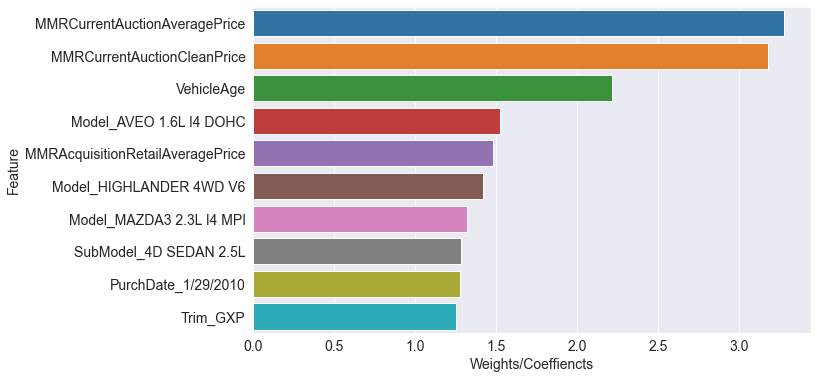

In [75]:
sns.barplot(data = model1_weights_df.head(10) , x = 'Weights/Coeffiencts' , y = 'Feature' )

In [76]:
train_preds = model1.predict(X_train)
val_preds = model1.predict(X_val)
test_preds = model1.predict(X_test)

In [77]:
train_preds , val_preds , test_preds

(array([0, 0, 0, ..., 0, 0, 0], dtype=int64),
 array([0, 0, 0, ..., 0, 0, 0], dtype=int64),
 array([0, 0, 0, ..., 0, 0, 0], dtype=int64))

## DECISION TREES 
Using decision trees can bring out better results than logistic regression in many cases.

In [78]:
from sklearn.tree import DecisionTreeClassifier

In [79]:
tree = DecisionTreeClassifier(random_state = 42)

In [80]:
%%time 
tree.fit(X_train , train_targets)

Wall time: 27.6 s


DecisionTreeClassifier(random_state=42)

In [81]:
tree.score(X_train , train_targets)

1.0

In [82]:
tree.score(X_val , val_targets)

0.8451051585942317

In [83]:
tree.score(X_test , test_targets)

0.8403781598958691

The score of the model on validation and test set are : 84.5 % and 84.03 % respectively

> Plotting tree and visualising 

In [84]:
from sklearn.tree import plot_tree , export_text

[Text(0.5, 0.9, 'VehicleAge <= 0.5\ngini = 0.217\nsamples = 43789\nvalue = [38369, 5420]'),
 Text(0.25, 0.7, 'WheelTypeID <= 0.582\ngini = 0.159\nsamples = 26681\nvalue = [24356, 2325]'),
 Text(0.125, 0.5, 'WheelTypeID <= 0.416\ngini = 0.216\nsamples = 11889\nvalue = [10426, 1463]'),
 Text(0.0625, 0.3, 'MMRAcquisitionAuctionAveragePrice <= 0.481\ngini = 0.133\nsamples = 10833\nvalue = [10055, 778]'),
 Text(0.03125, 0.1, '\n  (...)  \n'),
 Text(0.09375, 0.1, '\n  (...)  \n'),
 Text(0.1875, 0.3, 'Auction_MANHEIM <= 0.5\ngini = 0.456\nsamples = 1056\nvalue = [371, 685]'),
 Text(0.15625, 0.1, '\n  (...)  \n'),
 Text(0.21875, 0.1, '\n  (...)  \n'),
 Text(0.375, 0.5, 'MMRCurrentAuctionAveragePrice <= 0.134\ngini = 0.11\nsamples = 14792\nvalue = [13930, 862]'),
 Text(0.3125, 0.3, 'PurchDate_1/12/2010 <= 0.5\ngini = 0.19\nsamples = 2377\nvalue = [2125, 252]'),
 Text(0.28125, 0.1, '\n  (...)  \n'),
 Text(0.34375, 0.1, '\n  (...)  \n'),
 Text(0.4375, 0.3, 'BYRNO <= 1.0\ngini = 0.093\nsamples = 1

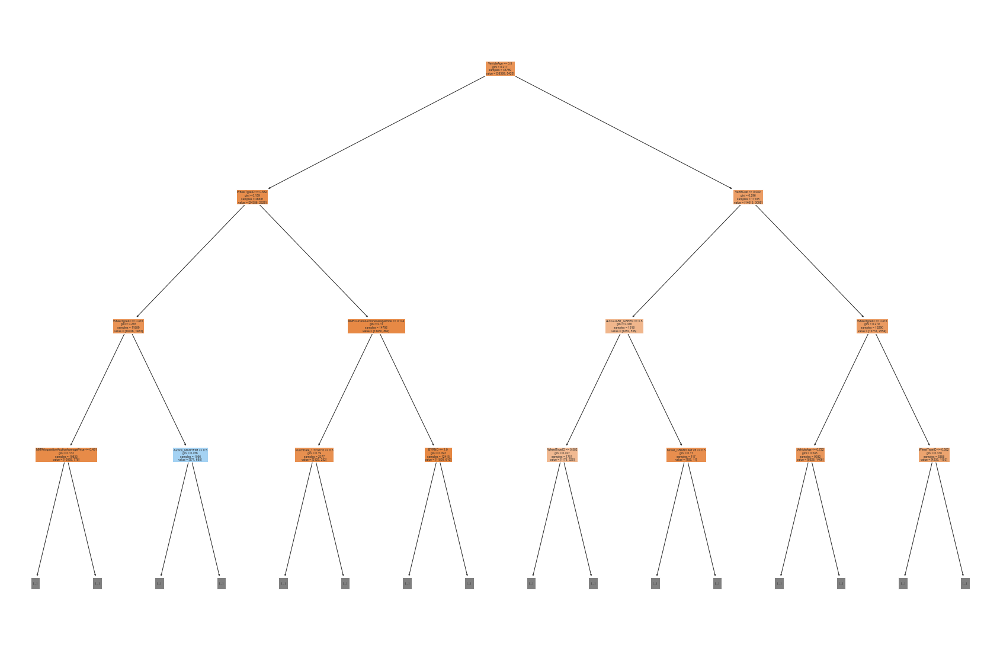

In [85]:
plt.figure(figsize = (30,20))
plot_tree(tree , feature_names = X_train.columns , max_depth = 3 , filled = True)

In [86]:
importances = tree.feature_importances_
importance_df = pd.DataFrame({
    'feature' : X_train.columns , 'Importance' : importances
})

In [87]:
importance_df = importance_df.sort_values('Importance',ascending = False)

In [88]:
importance_df.head(10)

,feature,Importance
2,WheelTypeID,0.139622
3,VehOdo,0.038277
14,VehBCost,0.036679
18,Auction_MANHEIM,0.025788
1,VehicleAge,0.024525
11,MMRCurrentRetailCleanPrice,0.023439
8,MMRCurrentAuctionAveragePrice,0.023375
13,VNZIP1,0.022912
10,MMRCurrentRetailAveragePrice,0.022242
12,BYRNO,0.021569


<AxesSubplot:xlabel='Importance', ylabel='feature'>

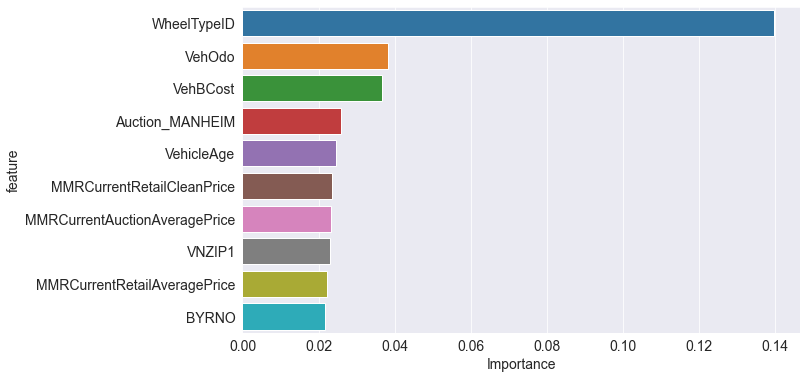

In [89]:
sns.barplot(data = importance_df.head(10) , x = 'Importance' , y = 'feature')

> Lets change the max_depth of the tree

In [90]:
tree_ = DecisionTreeClassifier(max_depth = 10 , random_state = 42)

In [91]:
%%time 
tree_.fit(X_train , train_targets)

Wall time: 5.87 s


DecisionTreeClassifier(max_depth=10, random_state=42)

In [92]:
tree_.score(X_train , train_targets)

0.9104112905067483

In [93]:
tree_.score(X_val , val_targets)

0.8948414057683085

In [94]:
tree_.score(X_test , test_targets)

0.8977872165513462

In [95]:
tree_1 = DecisionTreeClassifier(max_depth = 7 , random_state = 42)
tree_1.fit(X_train , train_targets)

DecisionTreeClassifier(max_depth=7, random_state=42)

In [96]:
tree_.score(X_train , train_targets)

0.9104112905067483

In [97]:
tree_.score(X_val , val_targets)

0.8948414057683085

In [98]:
tree_.score(X_test , test_targets)

0.8977872165513462

On trying different values of max_depth , we get similar score for max_depth = 10 and max_depth = 7 which are both signifincantly greater than the default value of max_depth for a decision tree

## RANDOM FORESTS

In [99]:
from sklearn.ensemble import RandomForestClassifier
forest_1 = RandomForestClassifier(n_jobs = -1 , random_state = 42)

In [100]:
%%time
forest_1.fit(X_train , train_targets)

Wall time: 19.7 s


RandomForestClassifier(n_jobs=-1, random_state=42)

In [101]:
forest_1.score(X_train , train_targets)

0.9999314896435177

In [102]:
forest_1.score(X_val , val_targets)

0.8786737000753579

In [103]:
forest_1.score(X_test , test_targets)

0.8817565253134205

Using random forests , we get an accuracy of almost 100% on the training data and about 88-89% on validation data and test data

In [104]:
forest_importance_df = pd.DataFrame({
  'feature': X_train.columns,
  'importance': forest_1.feature_importances_
}).sort_values('importance', ascending=False)

In [105]:
forest_importance_df.head(20)

,feature,importance
2,WheelTypeID,0.038809
3,VehOdo,0.037191
14,VehBCost,0.036828
9,MMRCurrentAuctionCleanPrice,0.034107
8,MMRCurrentAuctionAveragePrice,0.033804
11,MMRCurrentRetailCleanPrice,0.033756
5,MMRAcquisitionAuctionCleanPrice,0.033433
4,MMRAcquisitionAuctionAveragePrice,0.033181
10,MMRCurrentRetailAveragePrice,0.032712
7,MMRAcquisitonRetailCleanPrice,0.032076


<AxesSubplot:xlabel='importance', ylabel='feature'>

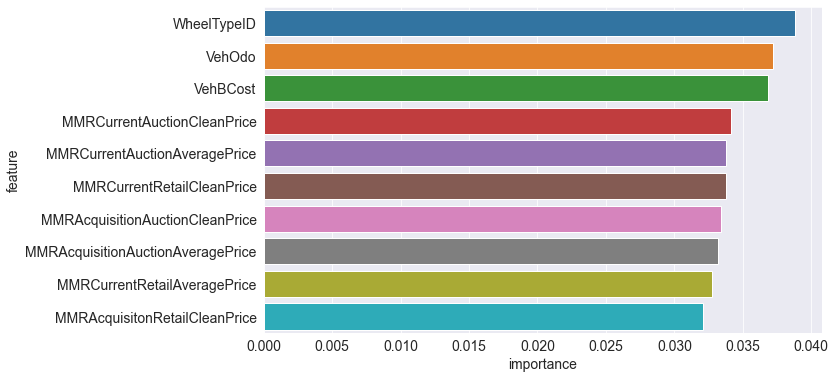

In [106]:
sns.barplot(data = forest_importance_df.head(10) , x = 'importance' , y = 'feature')

### Lets try hypertuning the parameters of the random forest to get better accuracy

In [107]:
base_accuracy = forest_1.score(X_train , train_targets) , forest_1.score(X_val , val_targets)

In [108]:
base_accuracy

(0.9999314896435177, 0.8786737000753579)

In [109]:
def test_parameters(**params):
    model = RandomForestClassifier(n_jobs = -1 , random_state = 42 , **params).fit(X_train , train_targets)
    return model.score(X_train , train_targets) , model.score(X_val , val_targets)

In [110]:
def test_and_plot(param_name, param_values):
    train_score, val_score = [], [] 
    for value in param_values:
        params = {param_name: value}
        train, val = test_parameters(**params)
        train_score.append(train)
        val_score.append(val)
    plt.figure(figsize=(10,6))
    plt.title('Overfitting curve: ' + param_name)
    plt.plot(param_values, train_score, 'b-o')
    plt.plot(param_values, val_score, 'r-o')
    plt.xlabel(param_name)
    plt.ylabel('Score')
    plt.legend(['Training', 'Validation'])

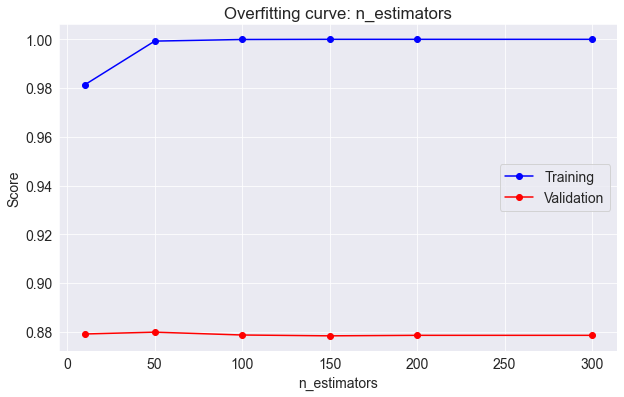

In [111]:
test_and_plot('n_estimators', [10 , 50 , 100 , 150 , 200 , 300])

> From the above plot we can say n_estimators best fit value can be around 10 only because after that the score is reaching to 1 which indicates overfitting

In [112]:
test_parameters(n_estimators = 10)

(0.9813195094658476, 0.879084743440433)

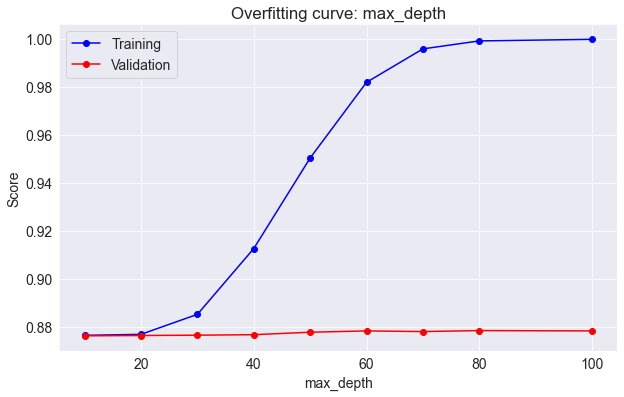

In [113]:
test_and_plot('max_depth' , [10,20,30,40,50,60,70,80,100])

> We can see the best fit value should be around 30-40 for max_depth

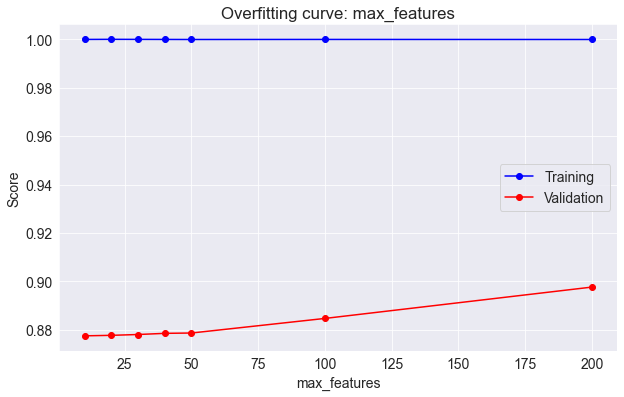

In [114]:
test_and_plot('max_features' , [10,20,30,40,50,100,200])

> the best fit value for max_features should be around 100-150

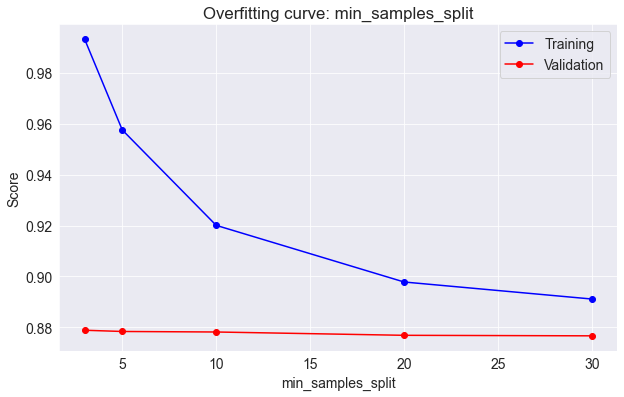

In [115]:
test_and_plot('min_samples_split' , [3,5,10,20,30]) 

## BEST MODEL WITH ABOVE PARAMETES 

In [116]:
forest_best = RandomForestClassifier(n_jobs = -1 , random_state = 42 , n_estimators = 100 , max_features = 150 , max_depth = 40)

In [117]:
forest_best.fit(X_train , train_targets)

RandomForestClassifier(max_depth=40, max_features=150, n_jobs=-1,
                       random_state=42)

In [118]:
forest_best.score(X_train , train_targets)

0.9549886957911804

In [119]:
forest_best.score(X_val , val_targets)

0.8914160443926834

In [120]:
forest_best.score(X_test , test_targets)

0.8955264780434335

## SAVING THE MODEL 

In [121]:
import joblib

In [122]:
model_final = {'model' : forest_best , 'imputer' : imputer , 'scaler' : scaler , 'encoder' : encoder , 'inputs' : input_columns , 'targets' : target_columns , 'numericColumns' : numeric_cols , 'categoricalColumns' : categorical_cols , 'encodedColumns' : encoded_cols}                  

In [123]:
joblib.dump(model_final ,'IsBadBuyPredictor.joblib')

['IsBadBuyPredictor.joblib']

# Summary
In this project :
Downloading the dataset
Visualising the Data 
Finding input and target columns 
Data Cleaning
Predicting values using logistic regression model
Predicting values using decision Trees and random forest
Hypertuning parameters to get best results
saving the model

# Resources 
https://www.kaggle.com/c/DontGetKicked

https://jovian.ai/learn/machine-learning-with-python-zero-to-gbms

In [124]:
jovian.commit(project_name = 'Course Project')

<IPython.core.display.Javascript object>

[jovian] Updating notebook "cpahuja0123/course-project-copy1" on https://jovian.ai/
[jovian] Committed successfully! https://jovian.ai/cpahuja0123/course-project-copy1


'https://jovian.ai/cpahuja0123/course-project-copy1'